In [4]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy.optimize import curve_fit
import astropy
import lightkurve as lk
from scipy.optimize import minimize
from lightkurve import search_lightcurvefile
from lightkurve import search_lightcurve

from astropy.table import Table, join, MaskedColumn, vstack, Column

import sys  
sys.path.append('/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/') #Edit this to your own file path
from Flare_model import flare_model

import astropy.units as u

sys.path.append('/Users/Tobin/Dropbox/Stellar_Flares_Project/Getting_Started/')
import stella
from tqdm import tqdm_notebook
import os, sys
from stella.download_nn_set import DownloadSets

In [5]:
lupita_tab=Table.read('lupita_tab_3.mrt', format='mrt')
lupita_tab

tpeak,FWHM,Amp,e_tpeak,e_FWHM,e_Amp,Source
d,d,,d,d,,
float64,float64,float64,str11,str11,float64,str6
539.6503088,0.00153389,0.008934698,6.49E-05,0.000213685,0.000716695,Kepler
539.8699037,0.000956397,0.01223805,8.61E-05,0.000185378,0.00213297,Kepler
541.1449682,0.002426536,0.007813247,5.18E-05,0.000187954,0.00037484,Kepler
541.1731539,0.003951658,0.011726901,0.000102912,0.000339299,0.000683433,Kepler
541.232336,0.002343955,0.007293593,9.96E-05,0.000387419,0.000749956,Kepler
541.3260872,0.001301046,0.017883518,3.42E-05,0.000187823,0.001811018,Kepler
...,...,...,...,...,...,...
1735.016156,0.005788368,0.013813325,0.00020527,0.000689931,0.001071153,TESS


In [6]:
import pickle

flare_info=pickle.load(open("/Users/Tobin/Dropbox/Stellar_Flares_Project/Getting_Started/Energies_and_rates.pkl", 'rb'))


#### start with a single sector

In [118]:
def get_lc(tic, sector_ind):
    sector_bool=flare_info['Flare_Bool'][sector_ind]
    search = lk.search_lightcurve(target=tic, mission='TESS', author='SPOC')

    search.table["dataURL"] = search.table["dataURI"]
    lc = search[sector_ind].download()
    mask_out_flares=lc[~sector_bool]
    
    return mask_out_flares

def syn_flare_insertion(lc, flare_amp, flare_fwhm, inserted_time_step):
    
    model_flare_flux=flare_model(lc['time'].value, lc['time'].value[inserted_time_step], 
                             flare_fwhm, flare_amp*np.median(lc.flux.value))
    
    
    
    fixed_mask=np.ma.filled(model_flare_flux, fill_value=0)
    
    fixed_mask2=np.nan_to_num(fixed_mask, nan=0)
    
    lc_with_inserted_flare=fixed_mask2+lc.flux.value
    
    return lc_with_inserted_flare


def recovery(lc, inserted_flare_flux, inserted_time_step):
    "Initialize Stella"
    OUT_DIR='/Users/Tobin/Dropbox/Stellar_Flares_Project/Getting Started/Results/'

    cnn = stella.ConvNN(output_dir=OUT_DIR)

    ds = DownloadSets()
    ds.download_models()

    MODELS=ds.models
    
    #Test recovery:
    preds = np.zeros((len(MODELS),len(lc['time'].value)))

    for i, model in enumerate(MODELS):
        cnn.predict(modelname=model,
                times=lc.time.value,
                fluxes=inserted_flare_flux,
                errs=lc['flux_err'].value)
        preds[i] = cnn.predictions[0]

    avg_pred = np.nanmedian(preds, axis=0)
    
    pred_at_inserterd_timestep = avg_pred[inserted_time_step]
    
    one_before=avg_pred[inserted_time_step-1]
    one_after=avg_pred[inserted_time_step+1]
    
    if pred_at_inserterd_timestep > 0.3 and one_before > 0.3 and one_after > 0.3:
        return True, avg_pred
    else:
        return False, None

def Injecting_each_flare_from_Lupitas_Model(tic, sector_ind):
    
    lc = get_lc(tic, sector_ind)
    
#     recovered_array=np.zeros(len(lupita_tab))
    
#     inserted_flare_array=np.zeros(len(lupita_tab), len(lc))
    
    recovered_array=np.zeros(len(lupita_tab))
    
    inserted_flare_array=np.zeros((len(lupita_tab), len(lc)))
    
    preds_for_recovered_flares=[]
    
    inserted_time_step=[]
    
    for i in range(len(lupita_tab)):
        rand_insertion_point=np.random.randint(0, len(lc), size=1)
        inserted_time_step.append(rand_insertion_point)
        
        inserted_flare=syn_flare_insertion(lc, lupita_tab['Amp'][i], lupita_tab['FWHM'][i], rand_insertion_point)
        inserted_flare_array[i]=inserted_flare
        
        recovered, pred = recovery(lc, inserted_flare, rand_insertion_point)
        
        recovered_array[i]= recovered
        if recovery:
            preds_for_recovered_flares.append(pred)
        
    return recovered_array, preds_for_recovered_flares, inserted_time_step, lc.time.value, inserted_flare_array




In [115]:
first10 = Injecting_each_flare_from_Lupitas_Model('tic272272592', 0)

/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:21: RuntimeWarning: overflow encountered in exp
  eqn = ((1 / 2) * np.sqrt(np.pi) * A * C * f1 * np.exp(-D1 * t + ((B / C) + (D1 * C / 2)) ** 2)
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:21: RuntimeWarning: invalid value encountered in multiply
  eqn = ((1 / 2) * np.sqrt(np.pi) * A * C * f1 * np.exp(-D1 * t + ((B / C) + (D1 * C / 2)) ** 2)
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:23: RuntimeWarning: overflow encountered in exp
  * np.exp(-D2 * t+ ((B / C) + (D2 * C / 2)) ** 2) * special.erfc(((B - t) / C) + (C * D2 / 2)))
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:22: RuntimeWarning: invalid value encountered in multiply
  * special.erfc(((B - t) / C) + (C * D1 / 2))) + ((1 / 2) * np.sqrt(np.pi) * A * C * f2


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 6ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.04s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.93s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.74s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]


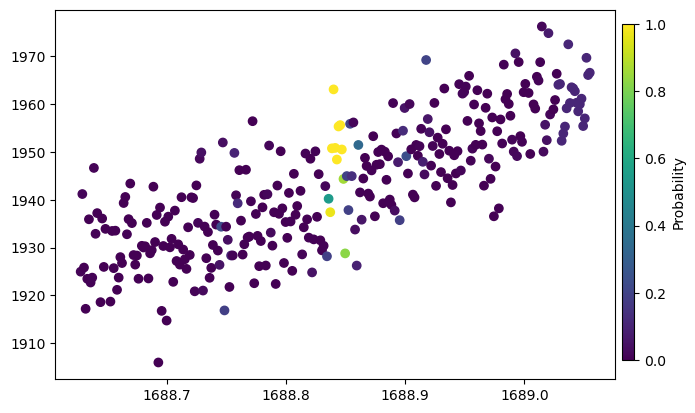

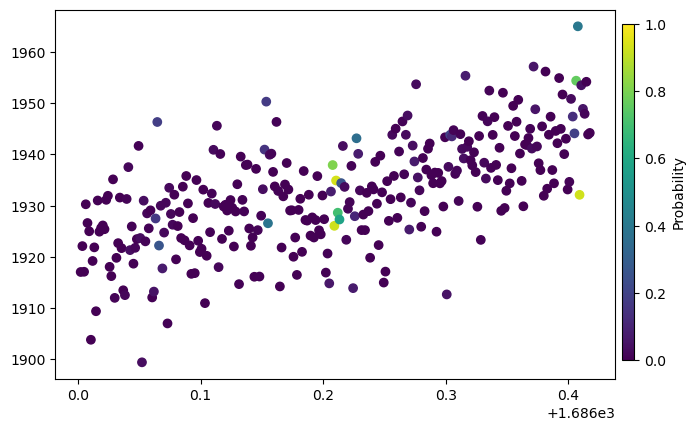

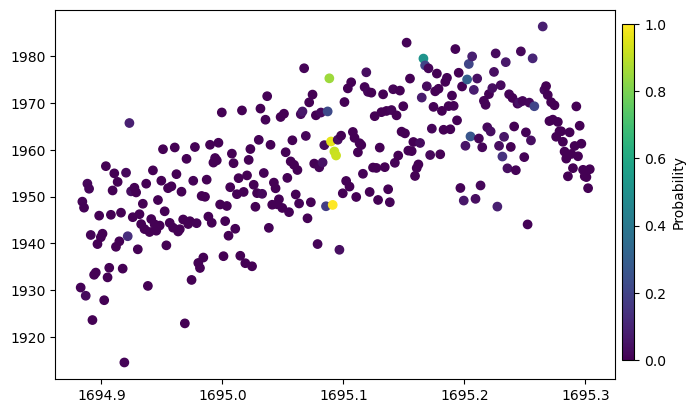

In [117]:
for i in range(len(first10[0])):
    if bool(first10[0][i]):
        fig=plt.figure()
        im=plt.scatter(first10[3][first10[2][i][0]-150:first10[2][i][0]+150], 
                    first10[4][0][first10[2][i][0]-150:first10[2][i][0]+150],
                    c=first10[1][i][first10[2][i][0]-150:first10[2][i][0]+150], vmin=0, vmax=1)

        cbar_ax = fig.add_axes([1.01, 0.15, 0.02, 0.7])
        fig.colorbar(im, cax=cbar_ax, label='Probability')

        fig.subplots_adjust(right=1)
        plt.show(fig)


### Running for every flare

In [119]:
each_flare = Injecting_each_flare_from_Lupitas_Model('tic272272592', 0)

/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:21: RuntimeWarning: overflow encountered in exp
  eqn = ((1 / 2) * np.sqrt(np.pi) * A * C * f1 * np.exp(-D1 * t + ((B / C) + (D1 * C / 2)) ** 2)
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:21: RuntimeWarning: invalid value encountered in multiply
  eqn = ((1 / 2) * np.sqrt(np.pi) * A * C * f1 * np.exp(-D1 * t + ((B / C) + (D1 * C / 2)) ** 2)
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:23: RuntimeWarning: overflow encountered in exp
  * np.exp(-D2 * t+ ((B / C) + (D2 * C / 2)) ** 2) * special.erfc(((B - t) / C) + (C * D2 / 2)))
/Users/Tobin/Dropbox/Stellar_Flares_Project/Lupita_Flare_Model/Llamaradas-Estelares/Flare_model.py:22: RuntimeWarning: invalid value encountered in multiply
  * special.erfc(((B - t) / C) + (C * D1 / 2))) + ((1 / 2) * np.sqrt(np.pi) * A * C * f2


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.93s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.73s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.15s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.73s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.70s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.69s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.69s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.70s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.53s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.56s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.46s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.46s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.53s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.92s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.53s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.54s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.64s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.46s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.53s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.55s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.55s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.47s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.44s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.49s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.50s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.51s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.48s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.54s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.24s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.88s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.94s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.83s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 5s 9ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.06s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:03<00:00,  3.01s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.16s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.02s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.05s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.10s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.02s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.00s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.10s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.98s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.20s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:05<00:00,  5.52s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.39s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.73s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.10s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.95s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.09s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.74s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.75s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.76s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.95s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.99s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.95s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.03s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.09s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.08s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.08s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.54s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.88s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.83s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.09s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 9s 16ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


100%|██████████████████████████| 1/1 [00:04<00:00,  4.20s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 5s 8ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.53s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 99s 181ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.93s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.46s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.86s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.98s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.13s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.03s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.15s/it]

Can only use stella.ConvNN.predict().


Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.47s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.21s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.98s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.00s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.05s/it]

Can only use stella.ConvNN.predict().


Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.00s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.99s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.12s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.99s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.04s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.09s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


100%|██████████████████████████| 1/1 [00:03<00:00,  3.25s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 5s 7ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.75s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.76s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.74s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.77s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.77s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.84s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.17s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.35s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.33s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.24s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.06s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.03s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.05s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.98s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.00s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.20s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.11s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.83s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.95s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.06s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.16s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  2.00s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.89s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.12s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.67s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.22s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.23s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  2.00s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.13s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.99s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.69s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.21s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.90s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.18s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.20s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.88s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.84s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.20s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.55s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.33s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  2.00s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.09s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.23s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.22s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.45s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.08s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.14s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 6ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.60s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.10s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.14s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.19s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.97s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.01s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.88s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.76s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.90s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:03<00:00,  3.18s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.87s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.04s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 5ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.03s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.90s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.94s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.12s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.76s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.91s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.07s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.94s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.94s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.14s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.95s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.90s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.83s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.73s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.82s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.30s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.96s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.88s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.92s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.79s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.84s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.84s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.80s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.75s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.77s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.75s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.85s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.89s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.82s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.56s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.76s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.64s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.69s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.64s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.86s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.08s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 3s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.70s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.78s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.70s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.52s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.69s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]


Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:02<00:00,  2.01s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.64s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.81s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.65s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.64s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.56s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 4ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 4s 6ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.71s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.77s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.72s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.70s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.68s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.61s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 2s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.58s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.57s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.63s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 3ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.67s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.66s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.60s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.62s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.59s/it]

Can only use stella.ConvNN.predict().
Models have already been downloaded to ~/.stella/models



  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


  0%|                                  | 0/1 [00:00<?, ?it/s]

546/546 [==============================] - 1s 2ms/step


100%|██████████████████████████| 1/1 [00:01<00:00,  1.73s/it]


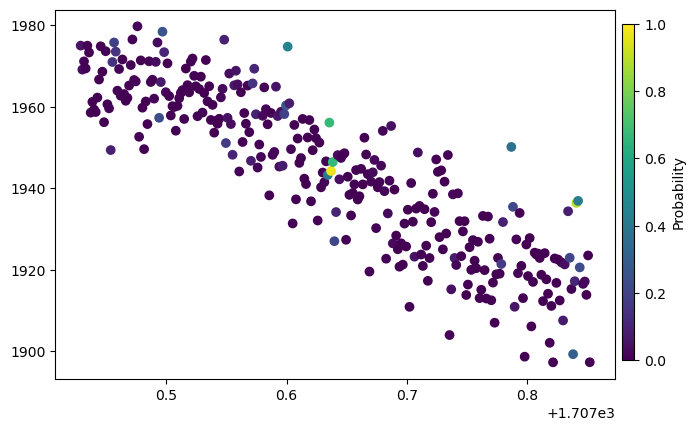

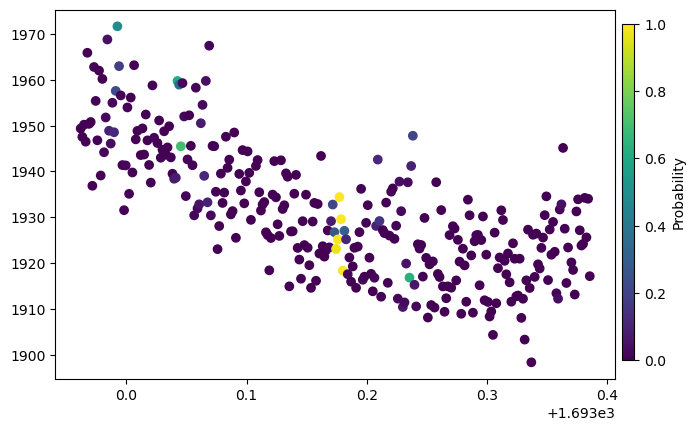

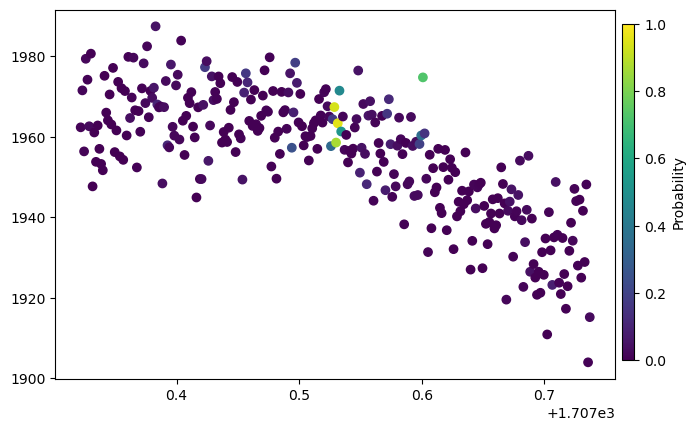

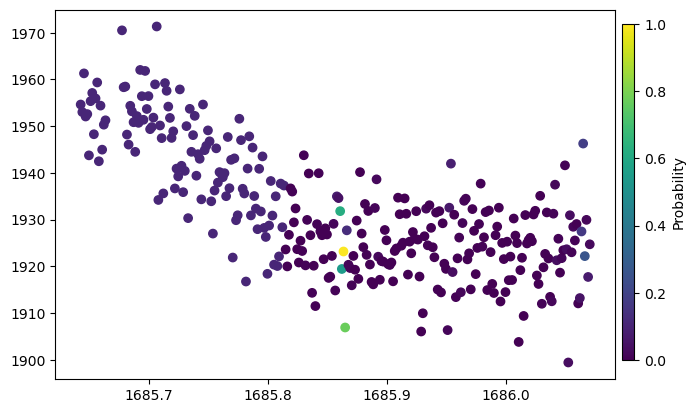

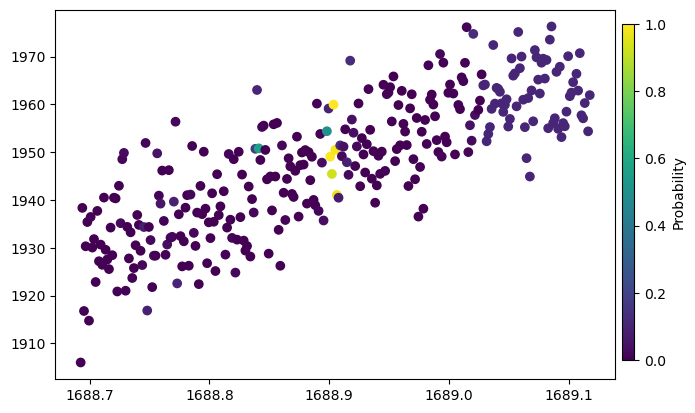

...

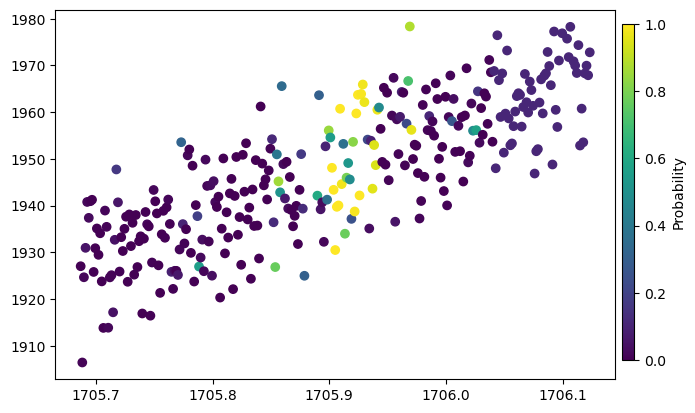

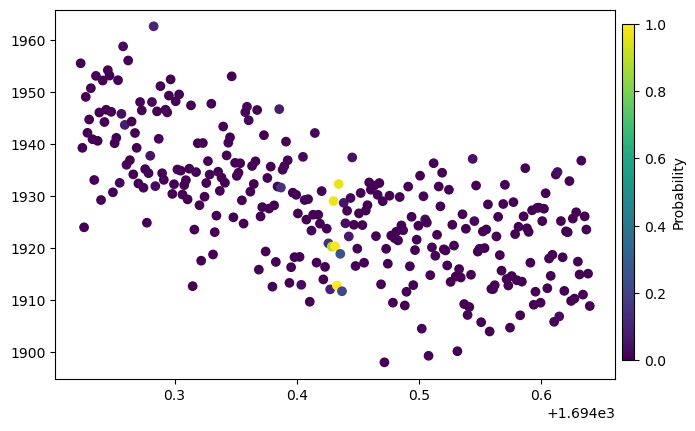

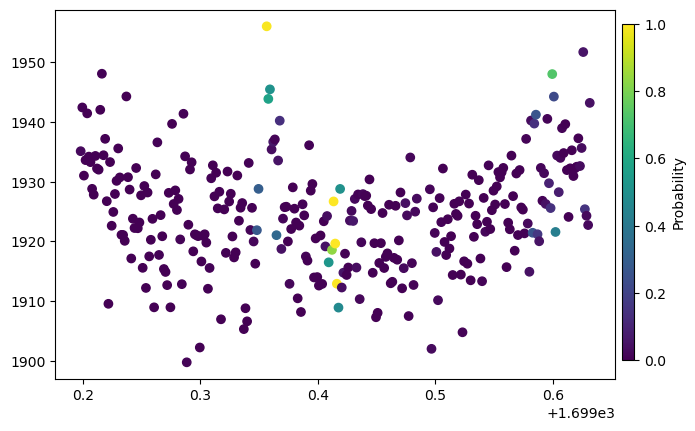

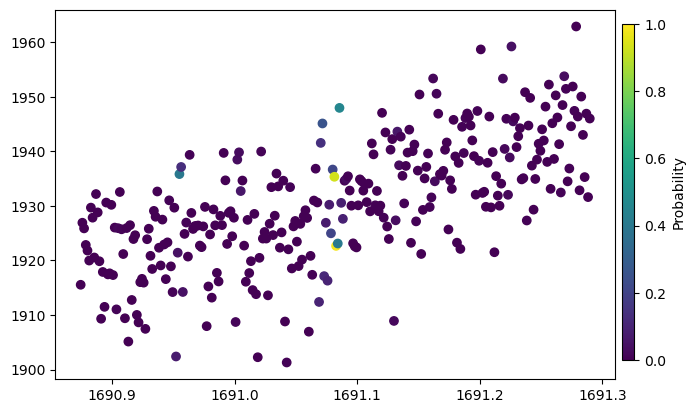

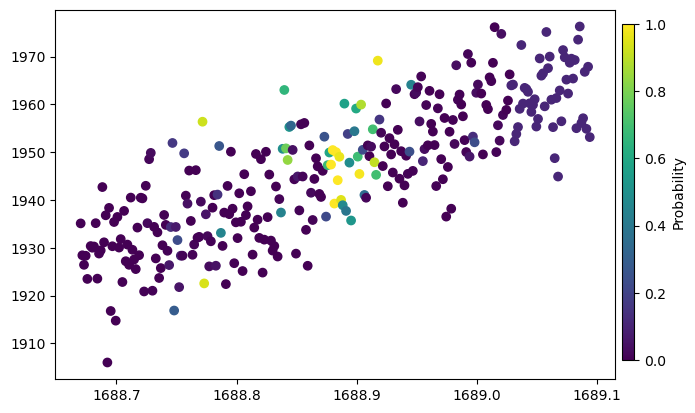

In [121]:
for i in range(len(each_flare[0])):
    if bool(each_flare[0][i]):
        fig=plt.figure()
        im=plt.scatter(each_flare[3][each_flare[2][i][0]-150:each_flare[2][i][0]+150], 
                    each_flare[4][0][each_flare[2][i][0]-150:each_flare[2][i][0]+150],
                    c=each_flare[1][i][each_flare[2][i][0]-150:each_flare[2][i][0]+150], vmin=0, vmax=1)

        cbar_ax = fig.add_axes([1.01, 0.15, 0.02, 0.7])
        fig.colorbar(im, cax=cbar_ax, label='Probability')

        fig.subplots_adjust(right=1)
        plt.show(fig)


In [ ]:
# Insert each flare 10 times for per sector, so each flare has a total of 50 total injections, recoveries

In [ ]:
# Bin the flares by energy, and make the S curve plot per energy bin

In [ ]:
# Trying to quantiy the 50%, 65%, 75% recovery threshold between sectors and across lightcurves. 